<a href="https://colab.research.google.com/github/Limkyuchan/Jupyter_Class/blob/main/Team_Project_Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 구글 드라이브 마운트 (구글 코랩과 구글 드라이브 연결)
from google.colab import drive
import os

drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
# 작업 경로 MyDrive로 변경 (구글드라이브 접속 후 바로 작업 디렉토리 확인 가능)

print('현재 작업 경로 : ', os.getcwd())
os.chdir('/content/drive/MyDrive')
print('변경된 작업 경로 : ', os.getcwd())

현재 작업 경로 :  /content
변경된 작업 경로 :  /content/drive/MyDrive


In [ ]:
# yolov5 레퍼지토리 다운로드

!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/drive/MyDrive/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.5/188.5 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 616.7/616.7 kB 23.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.3/59.3 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.9 MB/s eta 0:00:00


In [ ]:
# 사용할 데이터셋 경로 및 데이터셋의 yaml 파일 경로 지정
data_dir = '/content/drive/MyDrive/dataset/Fitness'
data_yaml = '/content/drive/MyDrive/dataset/Fitness/data.yaml'

In [ ]:
# 데이터셋 yaml 파일 확인
import yaml

with open(data_yaml) as f:
  film = yaml.load(f, Loader=yaml.FullLoader)
  display(film)

{'names': ['arm-curl',
  'back-extension',
  'cable-lat-pulldown',
  'chest-fly',
  'chest-press',
  'dip-chin-assist',
  'hip-abduction-adduction',
  'lat-pulldown',
  'leg-extension',
  'leg-press',
  'lying-down-leg-curl',
  'overhead-shoulder-press',
  'smith-machine'],
 'nc': 13,
 'roboflow': {'license': 'CC BY 4.0',
  'project': 'exercise-machine-team-project',
  'url': 'https://universe.roboflow.com/miimeunm/exercise-machine-team-project/dataset/1',
  'version': 1,
  'workspace': 'miimeunm'},
 'test': '../test/images',
 'train': '/content/drive/MyDrive/dataset/Fitness/train/images',
 'val': '/content/drive/MyDrive/dataset/Fitness/test/images'}

In [ ]:
# yaml 파일의 train, val 데이터가 있는 경로 수정 (기존 경로 -> 구글 드라이브에 저장된 경로로)

film['train'] = '/content/drive/MyDrive/dataset/Fitness/train/images'
film['val'] = '/content/drive/MyDrive/dataset/Fitness/test/images'

with open(data_yaml, 'w') as f:
  yaml.dump(film, f)

print('변경된 yaml 파일 : ')

with open(data_yaml) as f:
  film = yaml.load(f, Loader=yaml.FullLoader)
  display(film)

변경된 yaml 파일 : 


{'names': ['arm-curl',
  'back-extension',
  'cable-lat-pulldown',
  'chest-fly',
  'chest-press',
  'dip-chin-assist',
  'hip-abduction-adduction',
  'lat-pulldown',
  'leg-extension',
  'leg-press',
  'lying-down-leg-curl',
  'overhead-shoulder-press',
  'smith-machine'],
 'nc': 13,
 'roboflow': {'license': 'CC BY 4.0',
  'project': 'exercise-machine-team-project',
  'url': 'https://universe.roboflow.com/miimeunm/exercise-machine-team-project/dataset/1',
  'version': 1,
  'workspace': 'miimeunm'},
 'test': '../test/images',
 'train': '/content/drive/MyDrive/dataset/Fitness/train/images',
 'val': '/content/drive/MyDrive/dataset/Fitness/test/images'}

In [ ]:
!python train.py --img 640 --batch 8 --epochs 150 --data {data_yaml} --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/dataset/Fitness/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch origin' timed out after 5 seconds
YOLOv5 🚀 v7.0-207-gdf48c20 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.01

In [ ]:
# 텐서보드 시작하기

%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# 학습한 모델 테스트
test_data_dir = film['val']

train_exp_num = 9

In [ ]:
!python detect.py --weights runs/train/exp{train_exp_num}/weights/best.pt --img 640 --conf 0.1 --source {test_data_dir}

detect: weights=['runs/train/exp9/weights/best.pt'], source=/content/drive/MyDrive/dataset/Fitness/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-207-gdf48c20 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
image 1/172 /content/drive/MyDrive/dataset/Fitness/test/images/zArmCurlMuchine07_jpg.rf.24c83c3bf624fd8b802dbb720c731882.jpg: 640x640 1 arm-curl, 11.6ms
image 2/172 /content/drive/MyDrive/dataset/Fitness/test/images/zArmCurlMuchine101_jpg.rf.a6ad19207951448b5eb6f67f71712b5e.jpg: 640x640 1 overhead-shoulder-press, 

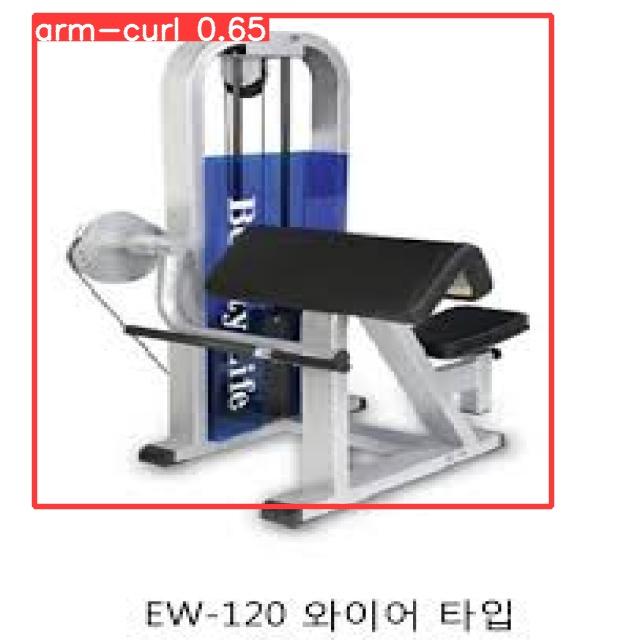

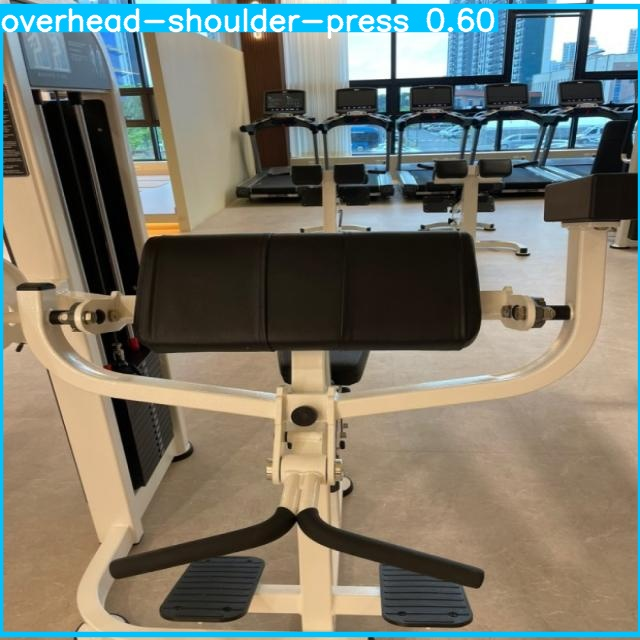

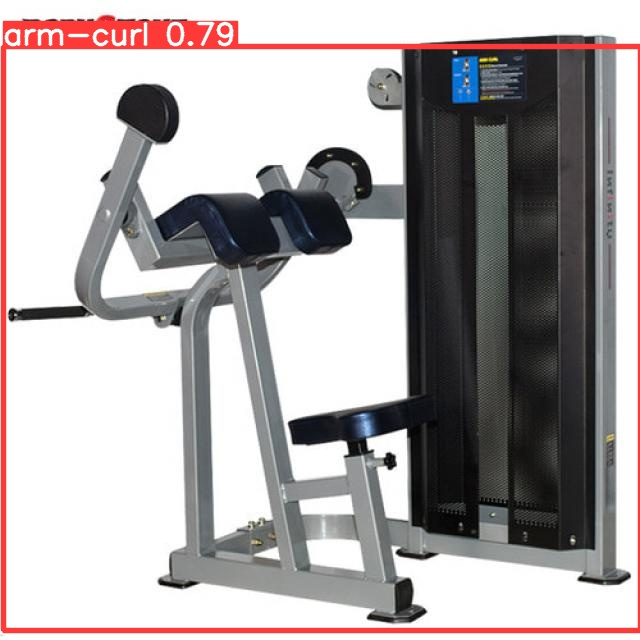

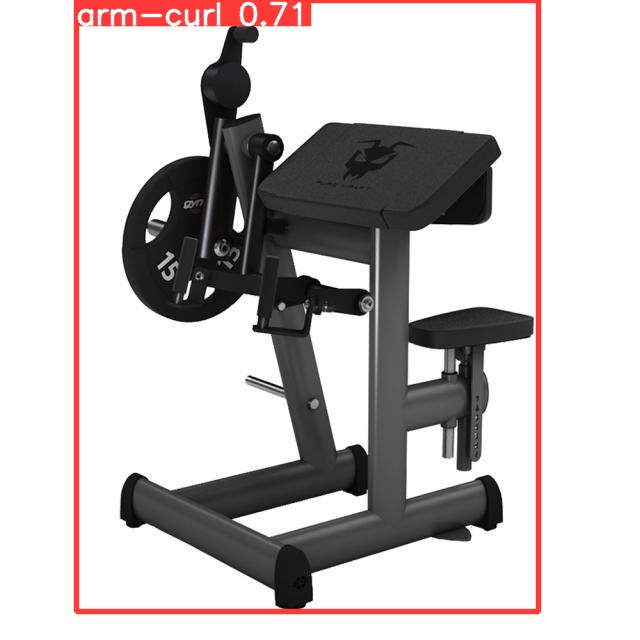

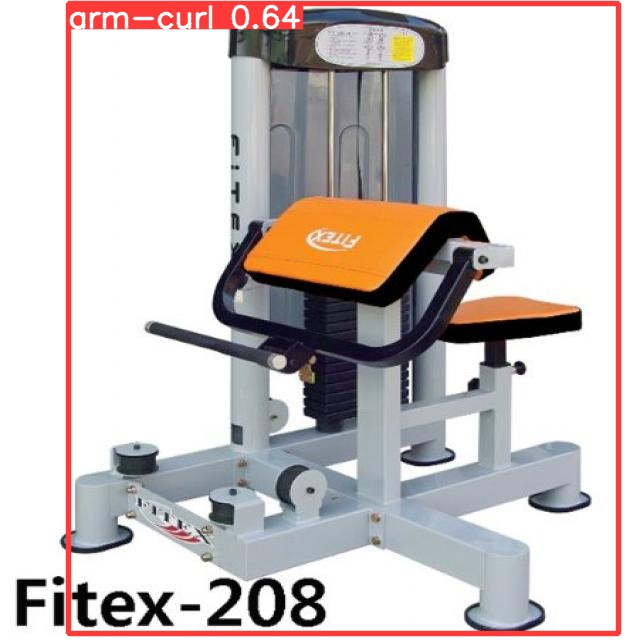

...

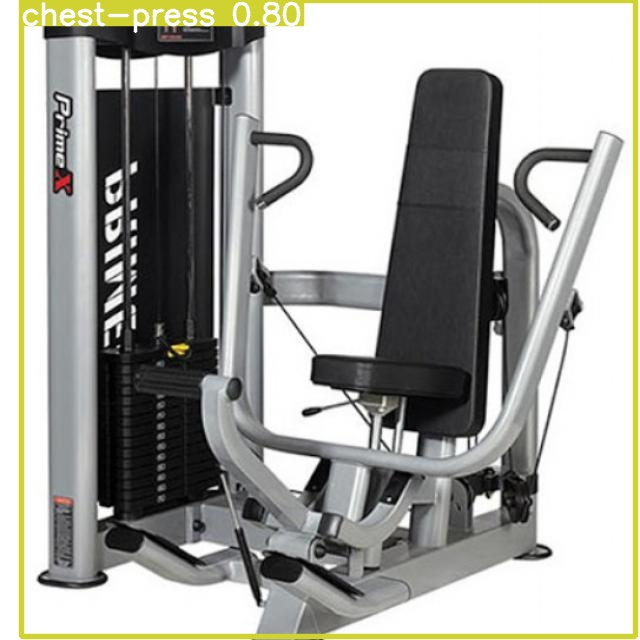

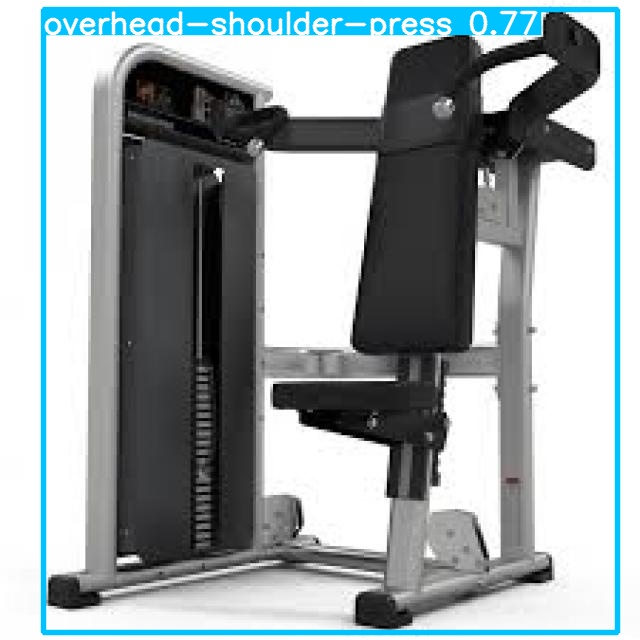

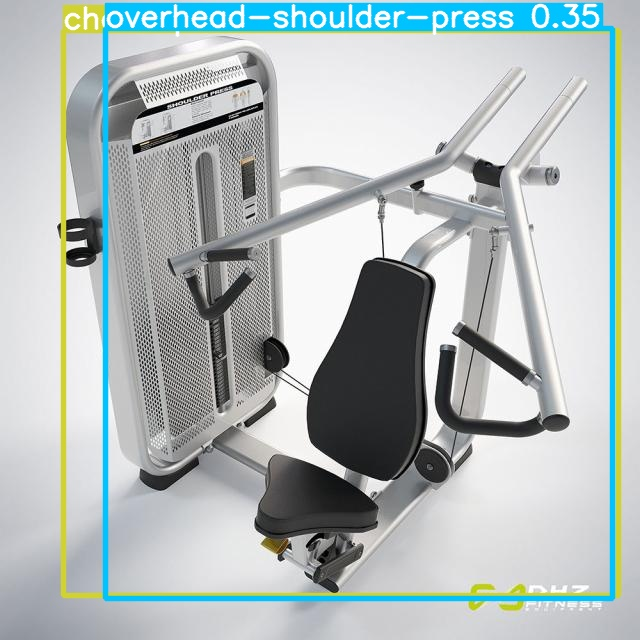

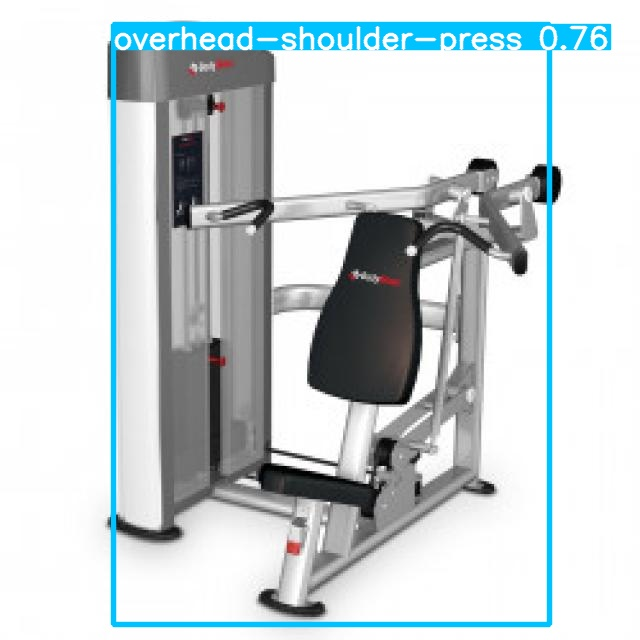

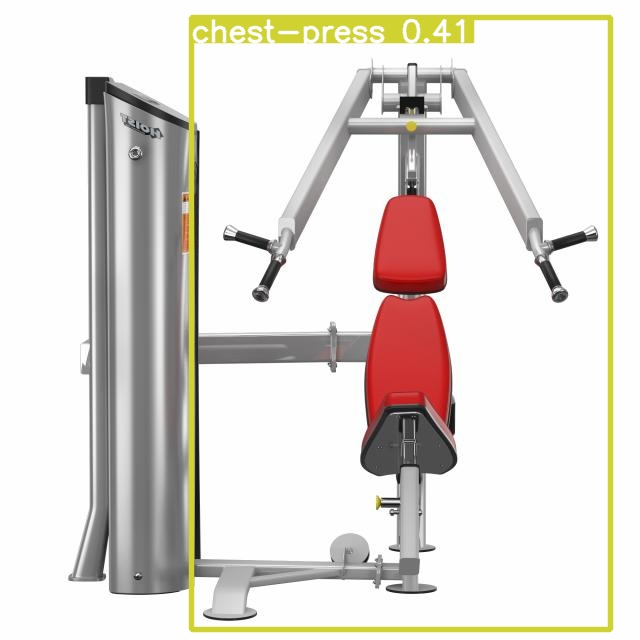

In [ ]:
# 테스트 결과 확인해보기
import glob
from IPython.display import Image, display

if not os.path.exists('/content/drive/MyDrive/yolov5/runs/detect/exp5/'):
  raise Exception('파일을 다시 확인하세요')

for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp5/*.jpg'):
  display(Image(filename = imageName))
  print("\n")

In [ ]:
!pip install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu113

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu113


<hr>

- 학습된 best.pt 불러오기

In [ ]:
import torch

model = torch.hub.load('ultralytics/yolov5', 'custom', path='./runs/train/exp9/weights/best.pt' )

/usr/local/lib/python3.10/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2023-8-11 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)



[Errno 2] No such file or directory: '/usr/local/lib/python3.10/dist-packages/pyparsing-3.1.1.dist-info/METADATA'


Fusing layers... 
Model summary: 157 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
Adding AutoShape... 


In [ ]:
# 저장된 이미지 데이터 예시

img = '/content/drive/MyDrive/dataset/Fitness/test/images/zcable-machine_72_jpg.rf.2ec6046cc59e415867a2da76e677127b.jpg'

In [ ]:
import pandas

try:
  results = model(img)
  image = results.pandas().xyxy[0].to_dict()
  print(image['name'][0])
except:
  print("사진 인식 실패")

cable-lat-pulldown


In [ ]:
!pip install dependencies

In [ ]:
import torch
from matplotlib import pyplot as plt
import numpy as np
import cv2

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

model

/usr/local/lib/python3.10/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2023-8-11 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)



[Errno 2] No such file or directory: '/usr/local/lib/python3.10/dist-packages/pyparsing-3.1.1.dist-info/METADATA'


Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


AutoShape(
  (model): DetectMultiBackend(
    (model): DetectionModel(
      (model): Sequential(
        (0): Conv(
          (conv): Conv2d(3, 32, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2))
          (act): SiLU(inplace=True)
        )
        (1): Conv(
          (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (act): SiLU(inplace=True)
        )
        (2): C3(
          (cv1): Conv(
            (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv2): Conv(
            (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv3): Conv(
            (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (m): Sequential(
            (0): Bottleneck(
              (cv1): Conv(
                (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
  

In [ ]:
from google.colab import files

uploaded = files.upload()

Saving sm.jpg to sm.jpg


In [ ]:
img = "sm.jpg"

In [ ]:
results = model(img)
results.print()

image 1/1: 225x225 (no detections)
Speed: 16.7ms pre-process, 48.0ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)


In [ ]:
import torch


AttributeError: ignored

In [ ]:
import torch

torch.save(model.state_dict(), 'model_transfer.pt')

NameError: ignored